In [2]:
import zipfile

!unzip /content/drive/MyDrive/tera/patho_1.zip -d /content/patho_1

Streaming output truncated to the last 5000 lines.
  inflating: /content/patho_1/Tomato Spider mites Two spotted spider mite/Tomato_Spider_mites_Two_spotted_spider_mite229.jpg  
  inflating: /content/patho_1/Tomato Spider mites Two spotted spider mite/Tomato_Spider_mites_Two_spotted_spider_mite23.jpg  
  inflating: /content/patho_1/Tomato Spider mites Two spotted spider mite/Tomato_Spider_mites_Two_spotted_spider_mite230.jpg  
  inflating: /content/patho_1/Tomato Spider mites Two spotted spider mite/Tomato_Spider_mites_Two_spotted_spider_mite231.jpg  
  inflating: /content/patho_1/Tomato Spider mites Two spotted spider mite/Tomato_Spider_mites_Two_spotted_spider_mite232.jpg  
  inflating: /content/patho_1/Tomato Spider mites Two spotted spider mite/Tomato_Spider_mites_Two_spotted_spider_mite233.jpg  
  inflating: /content/patho_1/Tomato Spider mites Two spotted spider mite/Tomato_Spider_mites_Two_spotted_spider_mite234.jpg  
  inflating: /content/patho_1/Tomato Spider mites Two spotted

In [3]:
import os

path = "/content/patho_1"
image_count = sum(len(files) for _, _, files in os.walk(path))

print(f"Total number of images: {image_count}")


Total number of images: 66556


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
import os
import warnings
warnings.filterwarnings("ignore")
from collections import defaultdict

import matplotlib.cm as cm
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import tensorflow as tf
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D, Input, Rescaling
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping

In [6]:
base_dir = 'patho_1'

classes = os.listdir(base_dir)

print('Classes in the dataset:', classes)

Classes in the dataset: ['potassium deficiency in plant', 'Grape Black rot', 'corn crop', 'onion', 'cabbage looper', 'Grape healthy', 'Tomato Early blight', 'Bacterial leaf blight in rice leaf', 'Garlic', 'Apple Cedar apple rust', 'Tomato healthy', 'potato crop', 'Tomato Leaf Mold', 'ginger', 'Cherry (including_sour) healthy', 'Tomato Bacterial spot', 'potato hollow heart', 'Tomato Late blight', 'Potato Early blight', 'Sogatella rice', 'Orange Haunglongbing Citrus greening', 'Brown spot in rice leaf', 'bird eye spot in tea', 'Pepper bell Bacterial spot', 'Raspberry healthy', 'brown blight in tea', 'Strawberry healthy', 'Pepper bell healthy', 'Strawberry Leaf scorch', 'Blight in corn Leaf', 'Gray Leaf Spot in corn Leaf', 'Tomato Target Spot', 'Apple Apple scab', 'healthy tea leaf', 'Tomato Septoria leaf spot', 'Potato healthy', 'Leaf smut in rice leaf', 'Grape Esca Black Measles', 'Cercospora leaf spot', 'Peach healthy', 'Cherry (including sour) Powdery mildew', 'red leaf spot in tea', 

In [7]:
def create_dataframe(base_dir, classes):
    data = []

    for label in classes:
        dir_path = os.path.join(base_dir, label)
        if os.path.isdir(dir_path):  # Ensure it's a valid directory
            for filename in os.listdir(dir_path):
                file_path = os.path.join(dir_path, filename)
                if os.path.isfile(file_path):  # Confirm it's a file
                    relative_path = os.path.relpath(file_path, base_dir)
                    data.append({"path": relative_path, "class": label})

    return pd.DataFrame(data)

df = create_dataframe(base_dir, classes)

print(df.head())
print(df.tail())


                                                path  \
0  potassium deficiency in plant/potassium defici...   
1  potassium deficiency in plant/potassium defici...   
2  potassium deficiency in plant/potassium defici...   
3  potassium deficiency in plant/potassium defici...   
4  potassium deficiency in plant/potassium defici...   

                           class  
0  potassium deficiency in plant  
1  potassium deficiency in plant  
2  potassium deficiency in plant  
3  potassium deficiency in plant  
4  potassium deficiency in plant  
                                               path               class
66551  Potato Late blight/Potato_Late_blight478.jpg  Potato Late blight
66552  Potato Late blight/Potato_Late_blight604.jpg  Potato Late blight
66553  Potato Late blight/Potato_Late_blight391.jpg  Potato Late blight
66554  Potato Late blight/Potato_Late_blight644.jpg  Potato Late blight
66555  Potato Late blight/Potato_Late_blight284.jpg  Potato Late blight


In [8]:
def display_dataset_images(df, base_dir, num_images_per_class=5):
    classes = df['class'].unique()

    plt.figure(figsize=(15, 3 * len(classes)))

    for i, class_name in enumerate(classes, start=1):
        class_df = df[df['class'] == class_name]
        class_images = class_df.head(num_images_per_class)

        for j, (_, row) in enumerate(class_images.iterrows(), start=1):
            plt.subplot(len(classes), num_images_per_class, (i - 1) * num_images_per_class + j)
            image_path = os.path.join(base_dir, row['path'])

            try:
                with Image.open(image_path) as img:
                    plt.imshow(img)
                plt.axis('off')
                plt.title(class_name)
            except Exception as e:
                print(f"Error loading image {image_path}: {e}")

    plt.tight_layout()
    plt.show()

display_dataset_images(df, base_dir, num_images_per_class=5)


In [9]:
def display_image_distribution(df):
    class_counts = {}

    for class_name in df['class'].unique():
        num_images = len(df[df['class'] == class_name])
        class_counts[class_name] = num_images

    print("\nImage Distribution per Class:\n" + "="*30)
    for class_name, count in class_counts.items():
        print(f"{class_name}: {count} images")

display_image_distribution(df)



Image Distribution per Class:
potassium deficiency in plant: 18 images
Grape Black rot: 3776 images
corn crop: 104 images
onion: 20 images
cabbage looper: 78 images
Grape healthy: 339 images
Tomato Early blight: 1000 images
Bacterial leaf blight in rice leaf: 40 images
Garlic: 49 images
Apple Cedar apple rust: 880 images
Tomato healthy: 1273 images
potato crop: 40 images
Tomato Leaf Mold: 952 images
ginger: 45 images
Cherry (including_sour) healthy: 684 images
Tomato Bacterial spot: 2127 images
potato hollow heart: 60 images
Tomato Late blight: 1909 images
Potato Early blight: 1000 images
Sogatella rice: 26 images
Orange Haunglongbing Citrus greening: 17624 images
Brown spot in rice leaf: 40 images
bird eye spot in tea: 100 images
Pepper bell Bacterial spot: 997 images
Raspberry healthy: 297 images
brown blight in tea: 113 images
Strawberry healthy: 365 images
Pepper bell healthy: 1183 images
Strawberry Leaf scorch: 888 images
Blight in corn Leaf: 1146 images
Gray Leaf Spot in corn Le

In [10]:
def get_image_sizes_per_directory(df, base_dir):
    sizes_per_directory = defaultdict(lambda: defaultdict(int))

    for _, row in df.iterrows():
        class_name = row['class']
        image_path = os.path.join(base_dir, row['path'])

        with Image.open(image_path) as img:
            width, height = img.size
            sizes_per_directory[class_name][(width, height)] += 1

    for class_name, size_dict in sizes_per_directory.items():
        print(f"{class_name}:")
        for size, count in size_dict.items():
            print(f"  Size: {size} -> {count} images")

get_image_sizes_per_directory(df, base_dir)


potassium deficiency in plant:
  Size: (162, 50) -> 1 images
  Size: (98, 140) -> 1 images
  Size: (162, 108) -> 4 images
  Size: (162, 101) -> 1 images
  Size: (162, 54) -> 1 images
  Size: (162, 83) -> 1 images
  Size: (162, 121) -> 2 images
  Size: (162, 98) -> 1 images
  Size: (143, 140) -> 1 images
  Size: (162, 113) -> 1 images
  Size: (162, 133) -> 1 images
  Size: (160, 140) -> 1 images
  Size: (93, 140) -> 1 images
  Size: (162, 79) -> 1 images
Grape Black rot:
  Size: (256, 256) -> 3776 images
corn crop:
  Size: (259, 194) -> 16 images
  Size: (310, 163) -> 1 images
  Size: (275, 183) -> 24 images
  Size: (100, 100) -> 29 images
  Size: (300, 168) -> 7 images
  Size: (207, 244) -> 1 images
  Size: (266, 189) -> 1 images
  Size: (225, 225) -> 2 images
  Size: (270, 187) -> 1 images
  Size: (299, 169) -> 1 images
  Size: (262, 193) -> 1 images
  Size: (262, 192) -> 3 images
  Size: (215, 235) -> 1 images
  Size: (166, 304) -> 1 images
  Size: (386, 131) -> 1 images
  Size: (283

In [13]:
X = df['path']
y = df['class']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print("Train set shape:", X_train.shape, y_train.shape)
print("Test set shape:", X_test.shape, y_test.shape)

Train set shape: (53244,) (53244,)
Test set shape: (13312,) (13312,)


In [14]:
# Get class names from test_generator
class_indices = test_generator.class_indices
print("Class indices dictionary:")
print(class_indices)

# Sort the class names by their index values to get the correct order
sorted_class_names = [k for k, v in sorted(class_indices.items(), key=lambda item: item[1])]
print("\nAll class names in order:")
for i, name in enumerate(sorted_class_names):
    print(f"{i}: {name}")

NameError: name 'test_generator' is not defined

In [15]:
def save_preprocessed_image(img_array, filename="preprocessed_test_image.npz"):

    if len(img_array.shape) == 3:
        img_array = np.expand_dims(img_array, axis=0)

    np.savez(filename, img_array=img_array)

    print(f"Preprocessed image saved to {filename}")
    print(f"Image shape: {img_array.shape}")
    print(f"Value range: min={np.min(img_array)}, max={np.max(img_array)}")

    return filename

In [ ]:
datagen = ImageDataGenerator(validation_split=0.125)

batch_size = 32

target_size=(512, 512)

train_generator = datagen.flow_from_dataframe(
    dataframe=pd.DataFrame({'path': X_train, 'class': y_train}),
    directory=base_dir,
    x_col='path',
    y_col='class',
    subset="training",
    target_size=target_size,
    batch_size=batch_size,
    seed=42,
    shuffle=True,
    class_mode='categorical',
    interpolation='bicubic'
)

validation_generator = datagen.flow_from_dataframe(
    dataframe=pd.DataFrame({'path': X_train, 'class': y_train}),
    directory=base_dir,
    x_col='path',
    y_col='class',
    subset="validation",
    target_size=target_size,
    batch_size=batch_size,
    seed=42,
    shuffle=True,
    class_mode='categorical',
    interpolation='bicubic'
)

test_datagen=ImageDataGenerator()
test_generator = test_datagen.flow_from_dataframe(
    dataframe=pd.DataFrame({'path': X_test, 'class': y_test}),
    directory=base_dir,
    x_col='path',
    y_col='class',
    target_size=target_size,
    batch_size=batch_size,
    seed=42,
    shuffle=False,
    class_mode='categorical',
    interpolation='bicubic'
)

Found 46589 validated image filenames belonging to 58 classes.
Found 6655 validated image filenames belonging to 58 classes.
Found 13312 validated image filenames belonging to 58 classes.


In [ ]:
tf.random.set_seed(42)

inputs = Input((512, 512, 3))

scale_layer = Rescaling(scale=1.0 / 127.5, offset=-1)

x = scale_layer(inputs)

base_model = InceptionV3(weights='imagenet', include_top=False)

base_model.trainable = False

x = base_model(x)

x = GlobalAveragePooling2D()(x)

x = Dense(1024, activation='relu')(x)

x = Dropout(0.2)(x)

outputs = Dense(len(classes), activation='softmax')(x)
model = Model(inputs=inputs, outputs=outputs)

model.compile(optimizer=Adam(learning_rate=1e-3), loss='categorical_crossentropy', metrics=['accuracy'])

model.summary()

87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 512, 512, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ rescaling (Rescaling)                │ (None, 512, 512, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ inception_v3 (Functional)            │ (None, 14, 14, 2048)        │      21,802,784 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 2048)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1024)                │       2,098,176 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 1024)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 58)                  │          59,450 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 23,960,410 (91.40 MB)

 Trainable params: 2,157,626 (8.23 MB)

 Non-trainable params: 21,802,784 (83.17 MB)

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint


patience = 5


epochs = 20


early_stopping = EarlyStopping(monitor='val_loss', patience=patience, restore_best_weights=True)


model_checkpoint = ModelCheckpoint(
    "best_model.h5",
    monitor="val_loss",
    save_best_only=True,
    mode="min",
    verbose=1
)

t
history = model.fit(
    train_generator,
    epochs=epochs,
    validation_data=validation_generator,
    callbacks=[early_stopping, model_checkpoint]
)


Epoch 1/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 524ms/step - accuracy: 0.7792 - loss: 0.8566
Epoch 1: val_loss improved from inf to 0.22823, saving model to best_model.h5


1456/1456 ━━━━━━━━━━━━━━━━━━━━ 941s 626ms/step - accuracy: 0.7793 - loss: 0.8563 - val_accuracy: 0.9234 - val_loss: 0.2282
Epoch 2/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step - accuracy: 0.9268 - loss: 0.2187
Epoch 2: val_loss improved from 0.22823 to 0.14942, saving model to best_model.h5


1456/1456 ━━━━━━━━━━━━━━━━━━━━ 879s 571ms/step - accuracy: 0.9268 - loss: 0.2187 - val_accuracy: 0.9494 - val_loss: 0.1494
Epoch 3/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step - accuracy: 0.9417 - loss: 0.1730
Epoch 3: val_loss did not improve from 0.14942
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 835s 573ms/step - accuracy: 0.9417 - loss: 0.1730 - val_accuracy: 0.9414 - val_loss: 0.1694
Epoch 4/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 502ms/step - accuracy: 0.9495 - loss: 0.1479
Epoch 4: val_loss improved from 0.14942 to 0.13720, saving model to best_model.h5


1456/1456 ━━━━━━━━━━━━━━━━━━━━ 837s 575ms/step - accuracy: 0.9495 - loss: 0.1479 - val_accuracy: 0.9515 - val_loss: 0.1372
Epoch 5/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 502ms/step - accuracy: 0.9534 - loss: 0.1343
Epoch 5: val_loss did not improve from 0.13720
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 837s 574ms/step - accuracy: 0.9534 - loss: 0.1343 - val_accuracy: 0.9432 - val_loss: 0.1546
Epoch 6/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 504ms/step - accuracy: 0.9600 - loss: 0.1112
Epoch 6: val_loss improved from 0.13720 to 0.12166, saving model to best_model.h5


1456/1456 ━━━━━━━━━━━━━━━━━━━━ 840s 577ms/step - accuracy: 0.9600 - loss: 0.1112 - val_accuracy: 0.9587 - val_loss: 0.1217
Epoch 7/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 510ms/step - accuracy: 0.9647 - loss: 0.1023
Epoch 7: val_loss did not improve from 0.12166
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 849s 583ms/step - accuracy: 0.9647 - loss: 0.1023 - val_accuracy: 0.9542 - val_loss: 0.1349
Epoch 8/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 513ms/step - accuracy: 0.9661 - loss: 0.0989
Epoch 8: val_loss improved from 0.12166 to 0.10115, saving model to best_model.h5


1456/1456 ━━━━━━━━━━━━━━━━━━━━ 855s 587ms/step - accuracy: 0.9661 - loss: 0.0989 - val_accuracy: 0.9680 - val_loss: 0.1012
Epoch 9/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 505ms/step - accuracy: 0.9692 - loss: 0.0873
Epoch 9: val_loss did not improve from 0.10115
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 843s 579ms/step - accuracy: 0.9692 - loss: 0.0873 - val_accuracy: 0.9570 - val_loss: 0.1248
Epoch 10/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 509ms/step - accuracy: 0.9723 - loss: 0.0810
Epoch 10: val_loss did not improve from 0.10115
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 849s 583ms/step - accuracy: 0.9723 - loss: 0.0810 - val_accuracy: 0.9582 - val_loss: 0.1431
Epoch 11/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step - accuracy: 0.9738 - loss: 0.0748
Epoch 11: val_loss did not improve from 0.10115
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 834s 573ms/step - accuracy: 0.9738 - loss: 0.0748 - val_accuracy: 0.9603 - val_loss: 0.1216
Epoch 12/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 507ms/step - accuracy: 0.9766 - loss: 0.0660
Ep

1456/1456 ━━━━━━━━━━━━━━━━━━━━ 848s 582ms/step - accuracy: 0.9766 - loss: 0.0660 - val_accuracy: 0.9684 - val_loss: 0.0977
Epoch 13/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 506ms/step - accuracy: 0.9757 - loss: 0.0684
Epoch 13: val_loss did not improve from 0.09772
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 842s 578ms/step - accuracy: 0.9757 - loss: 0.0684 - val_accuracy: 0.9668 - val_loss: 0.1033
Epoch 14/20
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 0s 501ms/step - accuracy: 0.9765 - loss: 0.0671
Epoch 14: val_loss did not improve from 0.09772
1456/1456 ━━━━━━━━━━━━━━━━━━━━ 835s 573ms/step - accuracy: 0.9765 - loss: 0.0671 - val_accuracy: 0.9617 - val_loss: 0.1218
Epoch 15/20
1032/1456 ━━━━━━━━━━━━━━━━━━━━ 3:34 505ms/step - accuracy: 0.9784 - loss: 0.0616

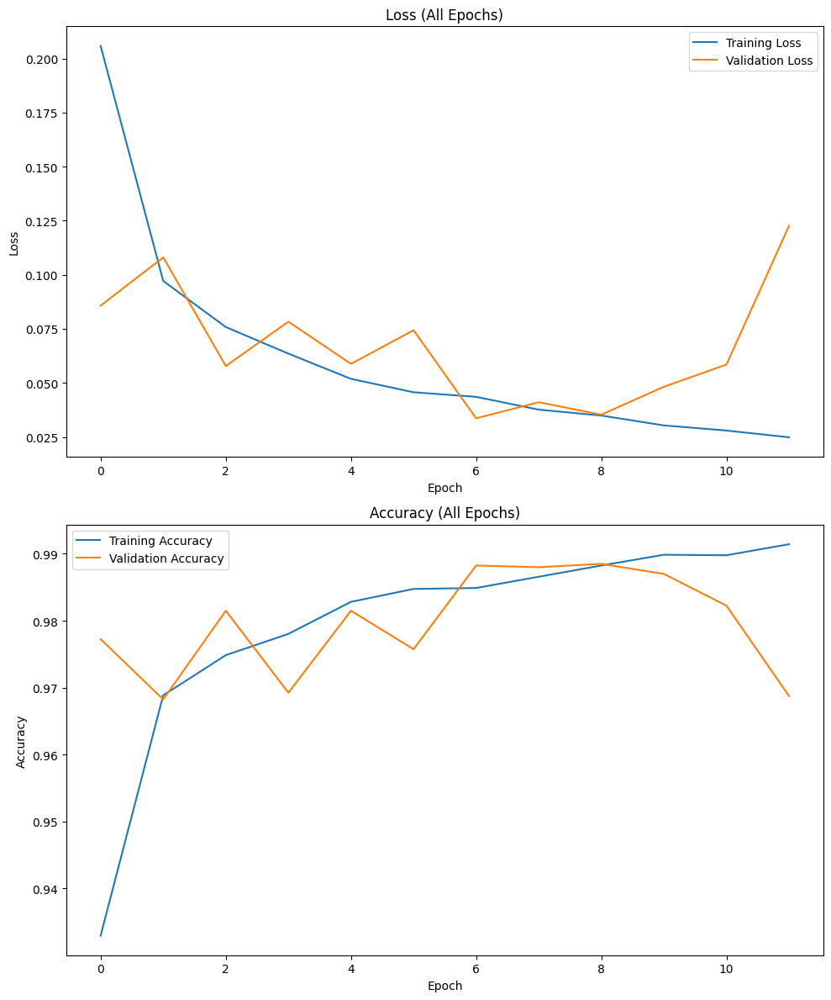

In [ ]:
def plot_metrics(history):

    loss_train = history.history['loss']
    loss_val = history.history['val_loss']
    acc_train = history.history['accuracy']
    acc_val = history.history['val_accuracy']


    fig, plots = plt.subplots(nrows=2, figsize=(10, 12))


    plots[0].plot(loss_train, label='Training Loss')
    plots[0].plot(loss_val, label='Validation Loss')
    plots[0].set_title('Loss (All Epochs)')
    plots[0].set_xlabel('Epoch')
    plots[0].set_ylabel('Loss')
    plots[0].legend()


    plots[1].plot(acc_train, label='Training Accuracy')
    plots[1].plot(acc_val, label='Validation Accuracy')
    plots[1].set_title('Accuracy (All Epochs)')
    plots[1].set_xlabel('Epoch')
    plots[1].set_ylabel('Accuracy')
    plots[1].legend()


    plt.tight_layout()
    plt.show()

plot_metrics(history)

416/416 ━━━━━━━━━━━━━━━━━━━━ 228s 531ms/step - accuracy: 0.9836 - loss: 0.0519
Loss on test data: 0.0525
Accuracy on test data: 0.9822
416/416 ━━━━━━━━━━━━━━━━━━━━ 233s 547ms/step
                                             precision    recall  f1-score   support

                           Apple Apple scab       1.00      1.00      1.00       424
                            Apple Black rot       0.99      1.00      0.99       402
                     Apple Cedar apple rust       0.98      1.00      0.99       166
                              Apple healthy       0.99      0.99      0.99       277
         Bacterial leaf blight in rice leaf       1.00      0.80      0.89        10
                        Blight in corn Leaf       0.96      0.86      0.90       242
                          Blueberry healthy       0.98      0.99      0.99       223
                    Brown spot in rice leaf       1.00      1.00      1.00         6
                       Cercospora leaf spot       1.00

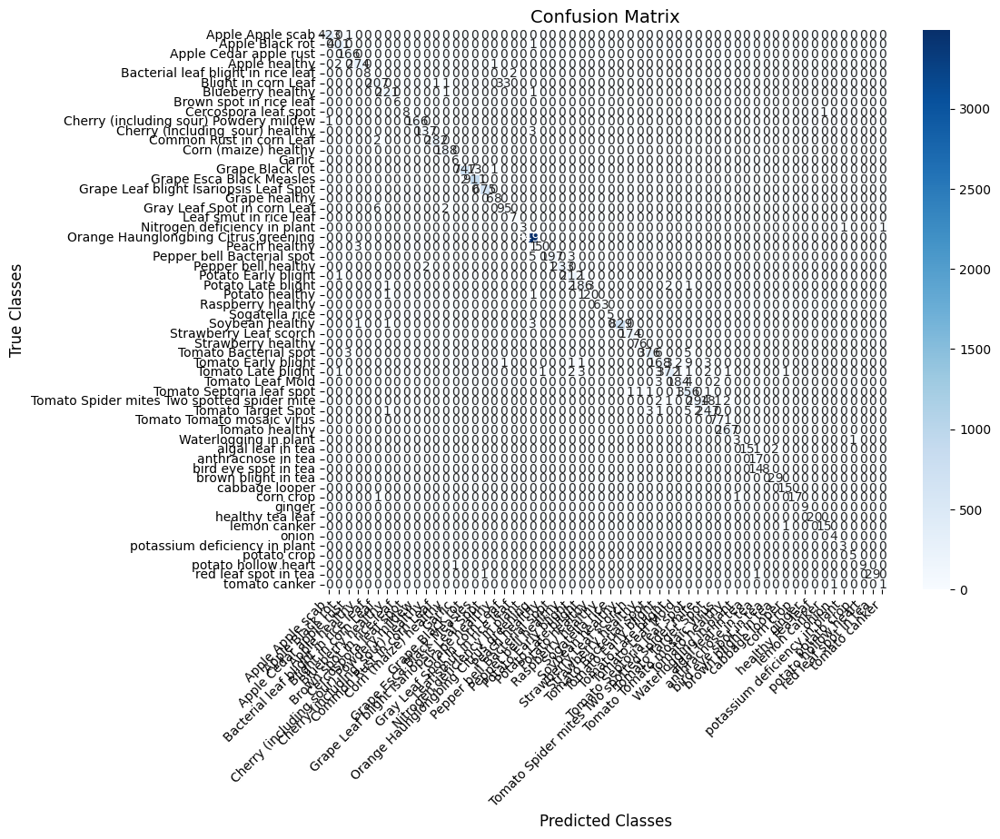

In [21]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.models import load_model
from sklearn.metrics import confusion_matrix, classification_report

# Load the trained model
best_model = load_model('/content/drive/MyDrive/tera/best_model.h5')

# Evaluate model performance
loss, accuracy = best_model.evaluate(test_generator)
print(f"Loss on test data: {loss:.4f}")
print(f"Accuracy on test data: {accuracy:.4f}")

# Get predictions
y_pred = best_model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Get true labels
y_true = test_generator.classes

# Compute confusion matrix
conf_matrix = confusion_matrix(y_true, y_pred_classes)

# Get class names
class_names = list(test_generator.class_indices.keys())

# Print classification report
report = classification_report(y_true, y_pred_classes, target_names=class_names)
print(report)

# **Improve Confusion Matrix Readability**
plt.figure(figsize=(10, 8))  # Increase figure size
sns.heatmap(conf_matrix,
            annot=True,
            fmt="d",
            cmap="Blues",
            xticklabels=class_names,
            yticklabels=class_names,
            linewidths=0.5,  # Add spacing between cells
            cbar=True,  # Keep color bar for reference
            annot_kws={"size": 10})  # Adjust annotation font size

plt.title("Confusion Matrix", fontsize=14)
plt.xlabel("Predicted Classes", fontsize=12)
plt.ylabel("True Classes", fontsize=12)

# Rotate x and y labels for better readability
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.yticks(rotation=0, fontsize=10)

plt.show()


In [19]:
# Define test data generator (without augmentation)
test_datagen = ImageDataGenerator()

# Create test_generator
test_generator = test_datagen.flow_from_dataframe(
    dataframe=pd.DataFrame({'path': X_test, 'class': y_test}),  # Ensure X_test and y_test are defined
    directory=base_dir,  # Ensure base_dir is correctly set
    x_col='path',
    y_col='class',
    target_size=(512, 512),  # Match your model's input size
    batch_size=32,  # Match your training setup
    seed=42,
    shuffle=False,  # No shuffling for evaluation
    class_mode='categorical',
    interpolation='bicubic'
)


Found 13312 validated image filenames belonging to 58 classes.


1/1 ━━━━━━━━━━━━━━━━━━━━ 22s 22s/step


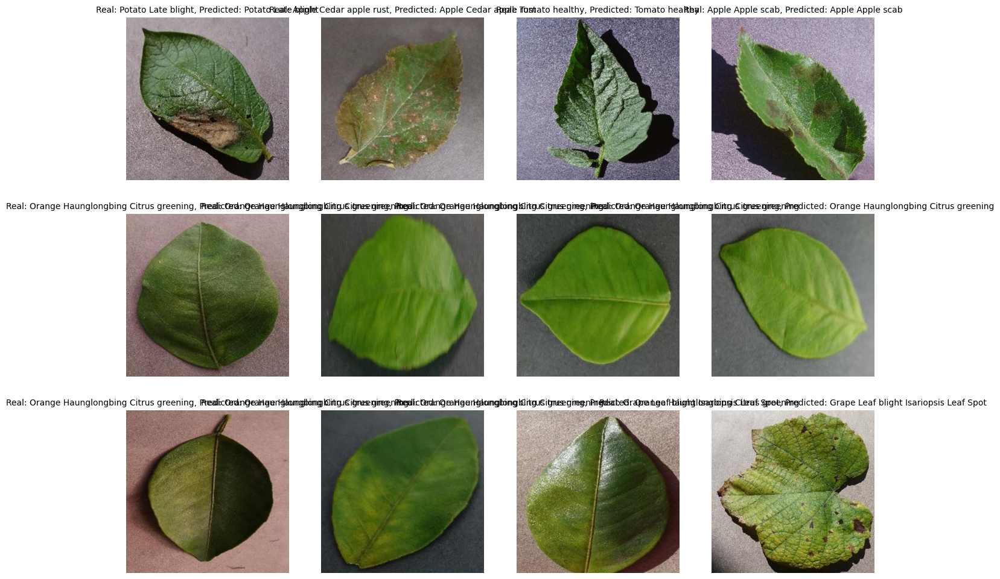

In [20]:
import numpy as np
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

# Load the saved model
best_model = load_model('/content/drive/MyDrive/tera/best_model.h5')

# Get the next batch of images from the test generator
batch = next(test_generator)
images, labels = batch

# Get predictions from the model for the batch images
predictions = best_model.predict(images)
predicted_labels = np.argmax(predictions, axis=1)

# Convert class_names to a list
class_names_list = list(test_generator.class_indices.keys())

# Display the first 12 images with their actual and predicted labels
plt.figure(figsize=(16, 12))
for i in range(12):
    plt.subplot(3, 4, i + 1)
    plt.imshow(images[i]/255.)
    plt.title(f'Real: {class_names_list[np.argmax(labels[i])]}, Predicted: {class_names_list[predicted_labels[i]]}', fontsize=10)
    plt.axis('off')

# Adjust spacing between subplots
plt.subplots_adjust(wspace=0.2, hspace=0.2)
plt.show()
